# Load modules

In [45]:
import numpy as np
import pandas as pd

from mpl_toolkits import mplot3d 
from itertools import chain

import pyemma

import matplotlib
import matplotlib.pyplot as plt 
from matplotlib import cm
%matplotlib inline
import seaborn as sns


import MDAnalysis
import mdtraj as md
import pyemma.plots as mplt


from IPython.display import Image
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
from sklearn.decomposition import KernelPCA
import hdbscan
from sklearn import metrics
from sklearn.cluster import KMeans
from kneed import KneeLocator
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

In [46]:
ls *dat

GAG-features.dat*                    h6s_ina-dh_phi-psi-ree-hb_pw.dat*
c4s_ina-dh_phi-psi-ree-hb_pw.dat*    h6s_ina-id-dh_phi-psi-ree-hb_pw.dat*
c4s_ina-id-dh_phi-psi-ree-hb_pw.dat* ha_ina-dh_phi-psi-ree-hb_pw.dat*
c6s_ina-dh_phi-psi-ree-hb_pw.dat*    ha_ina-id-dh_phi-psi-ree-hb_pw.dat*
c6s_ina-id-dh_phi-psi-ree-hb_pw.dat* id-GAG-features.dat*


# Load data files

In [47]:
data=np.loadtxt('id-GAG-features.dat',usecols=[1,2,3,4])
data1=np.loadtxt('id-GAG-features.dat', usecols=[0])

In [48]:
data1

array([0.0000e+00, 4.0000e+01, 8.0000e+01, ..., 9.9992e+05, 9.9996e+05,
       1.0000e+06])

In [49]:
df=pd.DataFrame(data)
df1=pd.DataFrame(data1)
df1.columns=['frame']
x1=df1.iloc[:,0].values

In [50]:
#df.columns=['frame','odd_dh', 'even_dh', 'r_ee','hbonds_pw']
df.columns=[r'$Linkage_{1}$', r'$Linkage_{2}$', r'$R_{ee}$', r'$Hbonds_{gw}$']
df.dropna(how="all", inplace=True) # drops the empty line at file-end
df.head()

,$Linkage_{1}$,$Linkage_{2}$,$R_{ee}$,$Hbonds_{gw}$
0,2.00000,2.00000,4.481715,83.0
1,1.98820,1.98090,4.564371,91.0
2,1.82725,1.99426,4.620765,91.0
3,1.50636,1.99882,4.519835,93.0
4,1.84822,1.98509,4.408473,85.0


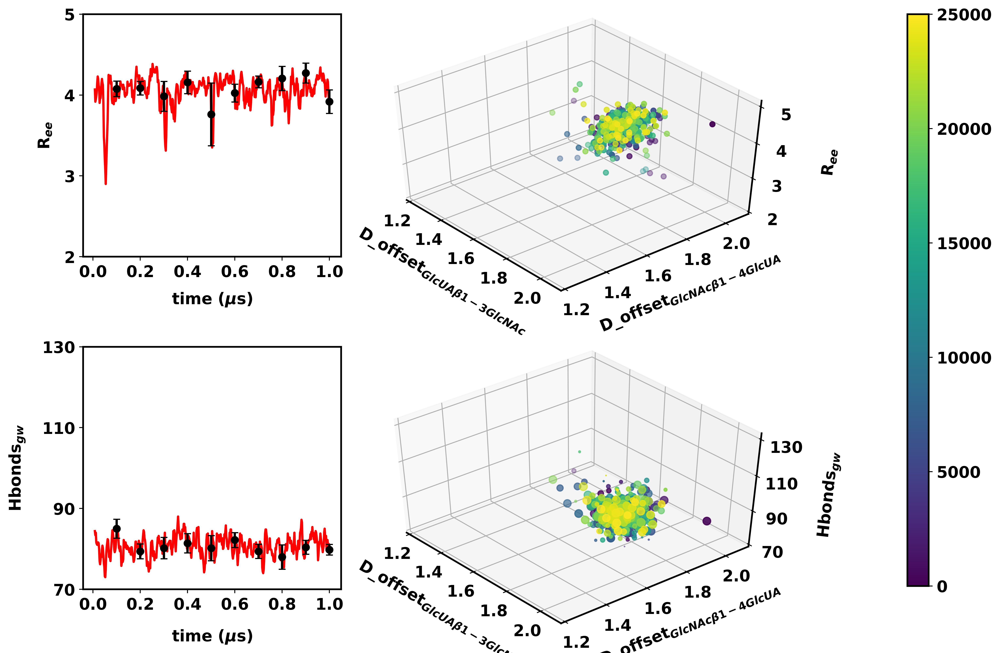

In [51]:
import matplotlib.cm as cmx
from mpl_toolkits.mplot3d import Axes3D
from collections import Counter
plt.rcParams["font.weight"] = "bold"
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams["axes.linewidth"] = 1.5
plt.rcParams["axes.edgecolor"] = "black"
plt.rcParams['font.size'] = 14
plt.rcParams["axes.labelpad"] = 14
plt.rcParams["axes.labelsize"] = "medium"
plt.rcParams["font.serif"] = "Times New Roman"
plt.rcParams["figure.dpi"] = 500 

cm = plt.get_cmap("viridis")
data1=np.loadtxt('id-GAG-features.dat')
df2=pd.DataFrame(data1)

x  = df2.iloc[0:25001:50,0].values
x1 = df2.iloc[0:25001:50,1].values
x2 = df2.iloc[0:25001:50,2].values

y  = df2.iloc[0:25001:50,3].values
y1 = df2.iloc[0:25001:50,3].map(df2.iloc[0:25001,3].value_counts())
y2 = df2.iloc[0:25001:50,3].rolling(window=5,center=False).mean()
y3 = df2.iloc[0:25001:50,3].rolling(window=5,center=False).std()/(np.sqrt(5))

z  = df2.iloc[0:25001:50,4].values
z1 = df2.iloc[0:25001:50,4].map(df2.iloc[0:25001,4].value_counts())
z2 = df2.iloc[0:25001:50,4].rolling(window=5,center=False).mean()
z3 = df2.iloc[0:25001:50,4].rolling(window=5,center=False).std()/(np.sqrt(5))
col = np.arange(501)

#fig, axs = plt.subplots(2, 2, figsize=(15, 5))
fig = plt.figure(figsize=(13, 10))
gs = fig.add_gridspec(15, 22)

labels = ['0.0', '0.2', '0.4', '0.6', '0.8', '1.0']
# 2D Plot
#fig = plt.figure(figsize=(10, 8))
ax1 = fig.add_subplot(gs[0:6, 0:7])
#axs[0, 0] = fig.add_subplot(111)
#ax.scatter(x, y, s=20, c=col, marker='o', cmap=cm)  
ax1.errorbar(x, y2, yerr=y3, linewidth=2,  elinewidth=2, marker='o', \
             errorevery=50, capsize=3, ecolor ='black', color='red', \
             barsabove=True, markevery=50, mfc='black',mec='black')  
#axs[0, 0].plot(x, y, linewidth=2)
ax1.set_xticks(np.arange(0, 1000001, 200000))
ax1.set_xticklabels(labels)
ax1.set_yticks(np.arange(2.0 ,5.1, 1.0))
ax1.set_xlabel('time ($\mu}$s)', labelpad = 10)
ax1.set_ylabel(r'R$_{ee}$', labelpad = 10)


#fig = plt.figure(figsize=(10, 8))
#axs[1, 0] = fig.add_subplot(111)
ax2 = fig.add_subplot(gs[8:14, 0:7])
#ax.scatter(x, y, s=20, c=col, marker='o', cmap=cm)   
#ax2.plot(x, z2,ls='--', marker='o', color='red', markevery=50 )
ax2.errorbar(x, z2, yerr=z3, linewidth=2,  elinewidth=2, marker='o', \
             errorevery=50, capsize=3, ecolor ='black', color='red', \
             barsabove=True, markevery=50, mfc='black',mec='black')
#axs[1, 0].plot(x, y, linewidth=2) 
ax2.set_xticks(np.arange(0, 1000001, 200000))
ax2.set_xticklabels(labels)
ax2.set_yticks(np.arange(70, 132, 20))
ax2.set_xlabel('time ($\mu}$s)')
ax2.set_ylabel(r'Hbonds$_{gw}$')


# 3D Plot
#fig = plt.figure(figsize=(10, 8))
#ax3 = fig.add_subplot(112, projection='3d')
ax3 = fig.add_subplot(gs[0:7, 7:19], projection='3d')
ax3.view_init(45, -40)
p3 = ax3.scatter(x1, x2, y, s=y1*20, c=col, marker='o', cmap=cm)  
#cbar=plt.colorbar(p3)
#cbar.set_ticks([0,100,200,300,400,500])
#cbar.set_ticklabels([0,5000,10000,15000,20000,25000])
ax3.set_xticks(np.arange(1.2, 2.1, 0.2))
ax3.set_yticks(np.arange(1.2, 2.1, 0.2))
ax3.set_zticks(np.arange(2.0 ,5.1, 1.0))

ax3.set(xlim=(1.2, 2.1),ylim=(1.2, 2.1), zlim=(2.0, 5.1))
ax3.set_xticklabels([1.2, 1.4, 1.6, 1.8, 2.0])
ax3.set_yticklabels([1.2, 1.4, 1.6, 1.8, 2.0])

ax3.set_ylabel(r"D_offset$_{GlcNAc{\beta}1-4GlcUA}$")
ax3.set_xlabel(r"D_offset$_{GlcUA{\beta}1-3GlcNAc}$")
ax3.set_zlabel(r'R$_{ee}$', rotation=90)


# 3D Plot
#fig = plt.figure(figsize=(10, 8))
#ax4 = fig.add_subplot(114, projection='3d')
ax4 = fig.add_subplot(gs[8:15, 7:19], projection='3d')
ax4.view_init(45, -40)
p4 = ax4.scatter(x1, x2, z, s=z1/10, c=col, marker='.', cmap=cm) 
cb_ax = fig.add_axes([0.90, 0.18, 0.02, 0.7])
cbar= plt.colorbar(p4, cax=cb_ax)
cbar.set_ticks([0,100,200,300,400,500])
cbar.set_ticklabels([0,5000,10000,15000,20000,25000])
ax4.set_xticks(np.arange(1.2, 2.1, 0.2))
ax4.set_yticks(np.arange(1.2, 2.1, 0.2))
ax4.set_zticks(np.arange(70,132, 20))


ax4.set(xlim=(1.2, 2.1),ylim=(1.2, 2.1), zlim=(70, 132))
ax4.set_xticklabels([1.2, 1.4, 1.6, 1.8, 2.0])
ax4.set_yticklabels([1.2, 1.4, 1.6, 1.8, 2.0])

ax4.set_ylabel(r"D_offset$_{GlcNAc{\beta}1-4GlcUA}$")
ax4.set_xlabel(r"D_offset$_{GlcUA{\beta}1-3GlcNAc}$")
ax4.set_zlabel(r'Hbonds$_{gw}$', rotation=90)

# rotate the axes and update
#for angle in range(0, 180):
    #ax3D.view_init(-90, angle)
    #plt.draw()
    #plt.pause(.001)

    
plt.savefig("GAG-Ree-Hb_2d->3d.pdf", transparent=True)
plt.show()


In [52]:
df2.iloc[0:25001:50,3].rolling(window=5,center=False).mean()

0             NaN
50            NaN
100           NaN
150           NaN
200      4.067957
           ...   
24800    4.190898
24850    4.161566
24900    4.012776
24950    3.921787
25000    3.918011
Name: 3, Length: 501, dtype: float64

In [53]:
df2.iloc[0:25001:50,4].rolling(window=5,center=False).std()/(np.sqrt(5))

0             NaN
50            NaN
100           NaN
150           NaN
200      2.561250
           ...   
24800    1.933908
24850    2.200000
24900    1.886796
24950    1.562050
25000    1.319091
Name: 4, Length: 501, dtype: float64

In [54]:
s=Counter(z)
print(s)

Counter({79.0: 49, 83.0: 41, 81.0: 39, 82.0: 37, 80.0: 36, 84.0: 35, 78.0: 32, 77.0: 29, 85.0: 23, 76.0: 22, 86.0: 22, 75.0: 20, 87.0: 16, 73.0: 15, 74.0: 14, 90.0: 13, 88.0: 11, 89.0: 8, 71.0: 8, 72.0: 8, 91.0: 7, 70.0: 4, 93.0: 3, 67.0: 2, 69.0: 2, 95.0: 2, 64.0: 1, 68.0: 1, 98.0: 1})


In [55]:
df3=df2.iloc[0:25001:10,0].values

# Choose scaler

In [56]:
scaler=StandardScaler()
#scaler=MinMaxScaler()
scaler.fit(df)

StandardScaler()

In [57]:
scaled_data=scaler.transform(df)

In [58]:
scaled_data

array([[ 4.17965608,  3.27912506,  1.32658093,  0.3964878 ],
       [ 4.00823868,  2.94889161,  1.57572983,  1.97470605],
       [ 1.67013443,  3.17988213,  1.74571483,  1.97470605],
       ...,
       [ 0.1514925 ,  0.20432311,  0.36034259,  0.19921052],
       [ 0.87522256,  0.07222973,  0.57888472, -0.5898986 ],
       [-0.42086729, -0.69128385,  0.85965686, -0.5898986 ]])

# PCA

In [59]:
pca=PCA(n_components=len(df2.columns)-1)
#pca=KernelPCA(n_components=2, kernel='linear')

In [60]:
pca.fit(scaled_data)

PCA(n_components=4)

In [61]:
x_pca=pca.transform(scaled_data)

In [62]:
scaled_data.shape

(25001, 4)

In [63]:
x_pca.shape

(25001, 4)

In [64]:
scaled_data

array([[ 4.17965608,  3.27912506,  1.32658093,  0.3964878 ],
       [ 4.00823868,  2.94889161,  1.57572983,  1.97470605],
       [ 1.67013443,  3.17988213,  1.74571483,  1.97470605],
       ...,
       [ 0.1514925 ,  0.20432311,  0.36034259,  0.19921052],
       [ 0.87522256,  0.07222973,  0.57888472, -0.5898986 ],
       [-0.42086729, -0.69128385,  0.85965686, -0.5898986 ]])

In [65]:
x_pca

array([[-3.09773614,  2.37144138,  3.55526555, -1.50983082],
       [-2.85644568,  1.09473101,  4.50934151, -1.2051758 ],
       [-1.36614592,  1.15930022,  4.04075777,  0.55671231],
       ...,
       [-0.27208356,  0.01442727,  0.35488912,  0.18451459],
       [-1.10542302,  0.4292664 , -0.08886833, -0.20048008],
       [-0.55249313, -0.23401138, -0.86428972,  0.79686022]])

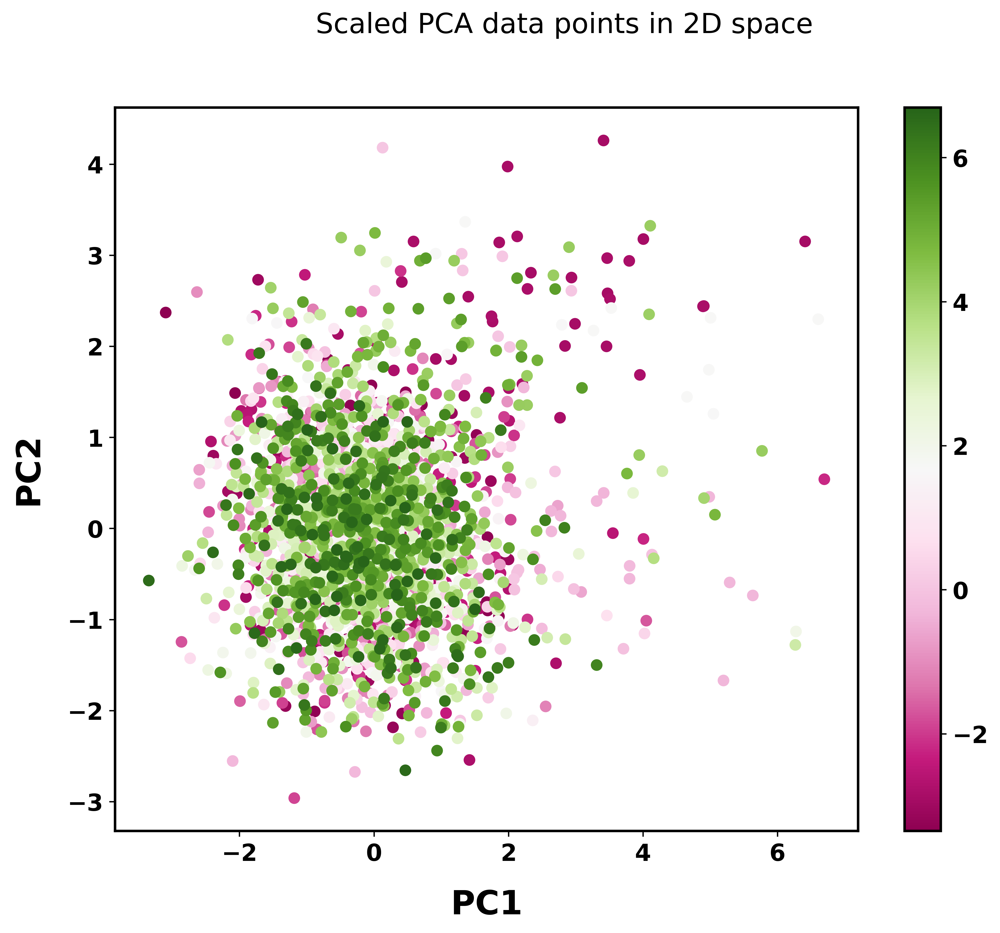

In [66]:
fig= plt.figure(figsize=(10,8))
fig.suptitle('Scaled PCA data points in 2D space')
z1=np.linspace(min(chain(x_pca[0:25001:10,0], x_pca[0:25001:10,1])),max(chain(x_pca[0:25001:10,0], \
                                                                              x_pca[0:25001:10,1])),2501)
surf= plt.scatter(x_pca[0:25001:10,0],x_pca[0:25001:10,1],c=z1, cmap='PiYG')
plt.colorbar(surf)
plt.xlabel('PC1', fontsize = 20.0)
plt.ylabel('PC2', fontsize = 20.0)
plt.savefig("GAG-scaled-PCs.pdf", transparent=True)

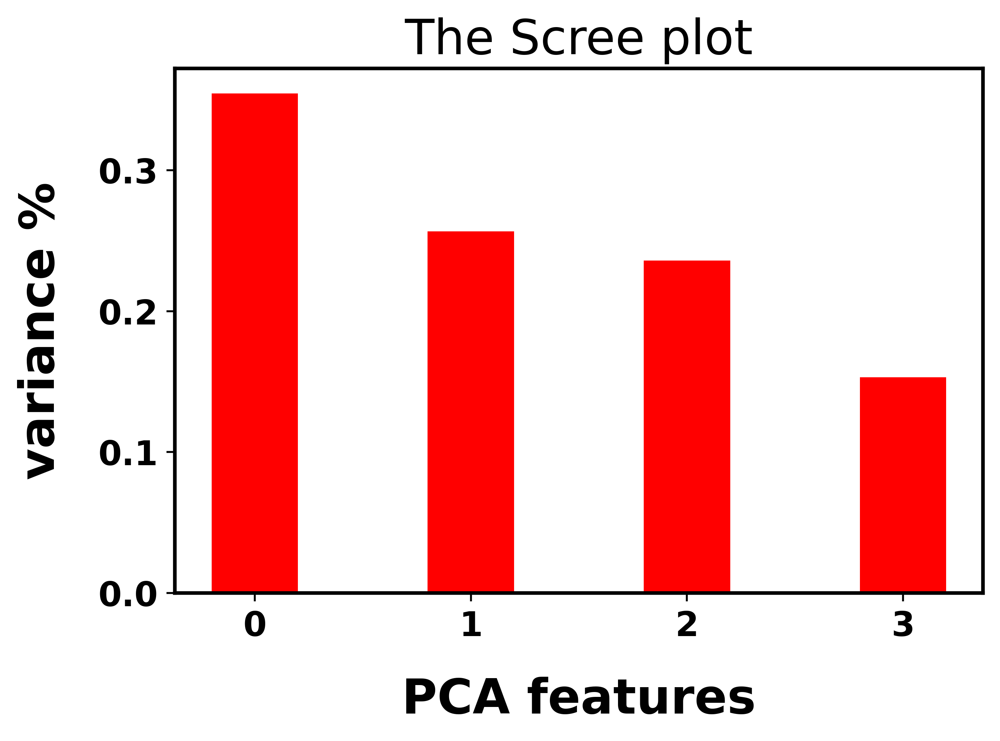

In [67]:
# Plot the explained variances
features = range(pca.n_components_)
plt.bar(features, pca.explained_variance_ratio_,width=0.4, color='red')
plt.xlabel('PCA features', fontsize = 20.0)
plt.ylabel('variance %', fontsize = 20.0)
plt.title('The Scree plot', fontsize = 20.0)
plt.xticks(features)
plt.savefig("GAG-ScreePlot.pdf", transparent=True)
plt.show()

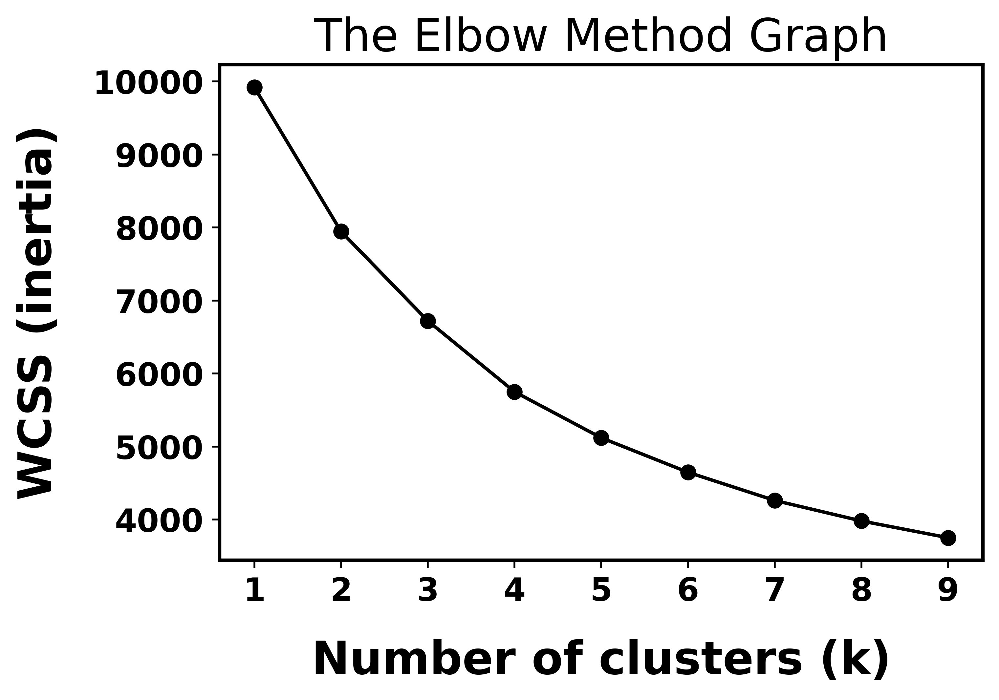

In [68]:
import os
ks = range(1, 10)
inertias = []
for k in ks:
    # Create a KMeans instance with k clusters: model
    model = KMeans(n_clusters=k)
    
    # Fit model to samples
    model.fit(x_pca[0:25001:10,])
    
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)
    

np.savetxt("GAG-Elbow.dat", np.c_[ks, inertias], fmt='%1.3f')

plt.plot(ks, inertias, '-o', color='black')
plt.title('The Elbow Method Graph', fontsize = 20.0)
plt.xlabel('Number of clusters (k)', fontsize = 20.0)
plt.ylabel('WCSS (inertia)', fontsize = 20.0)
plt.xticks(ks)
plt.savefig("GAG-Elbow-method.pdf", transparent=True)
plt.show()

In [69]:
model = KMeans(n_clusters=4, init ='k-means++', max_iter=300, n_init=10,random_state=0 )
y_kmeans = model.fit_predict(x_pca[0:25001:10,])

In [70]:
from scipy.cluster.hierarchy import linkage

hc_complete = linkage(x_pca[0:25001:10,], "complete")

hc_weighted = linkage(x_pca[0:25001:10,], method="weighted")
hc_single = linkage(x_pca[0:25001:10,], "single")


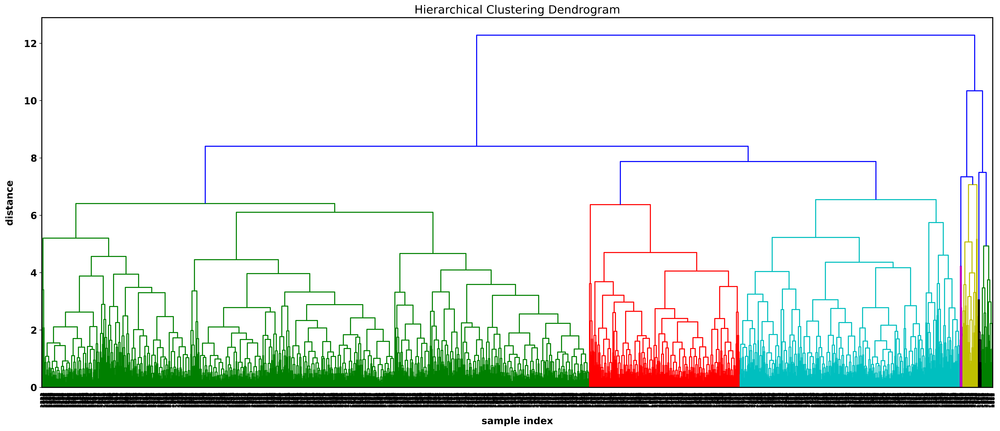

In [71]:
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster import hierarchy

# calculate full dendrogram

plt.figure(figsize=(25, 10))
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')
d= dendrogram(
    hc_complete,
    leaf_rotation=90.,  # rotates the x axis labels
    leaf_font_size=8.,  # font size for the x axis labels 
    color_threshold=7.3
)
plt.savefig("GAG-dendogram-cluster.pdf", transparent=True)
plt.show()

In [72]:
0.7*np.max(x_pca[0:25001:10,])

4.686633825837105

In [73]:
d['color_list']

['g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g',
 'g'

In [74]:
from scipy.cluster.hierarchy import cut_tree
print(cut_tree(hc_complete, n_clusters = 4).T) # Printing transpose just for space

[[0 0 1 ... 0 1 1]]


In [75]:
model.n_iter_

37

In [76]:
kl = KneeLocator(range(1, 10), inertias, curve="convex", direction="decreasing")

In [77]:
kl.elbow

4

In [78]:
silhouette_coefficients = []

# Notice you start at 2 clusters for silhouette coefficient
for k in range(2, 10):
     ks = KMeans(n_clusters=k, init ='k-means++', max_iter=300, n_init=10,random_state=0 )
     ks.fit(x_pca[0:25001:10,])
     score = silhouette_score(x_pca[0:25001:10,], ks.labels_)
     silhouette_coefficients.append(score)

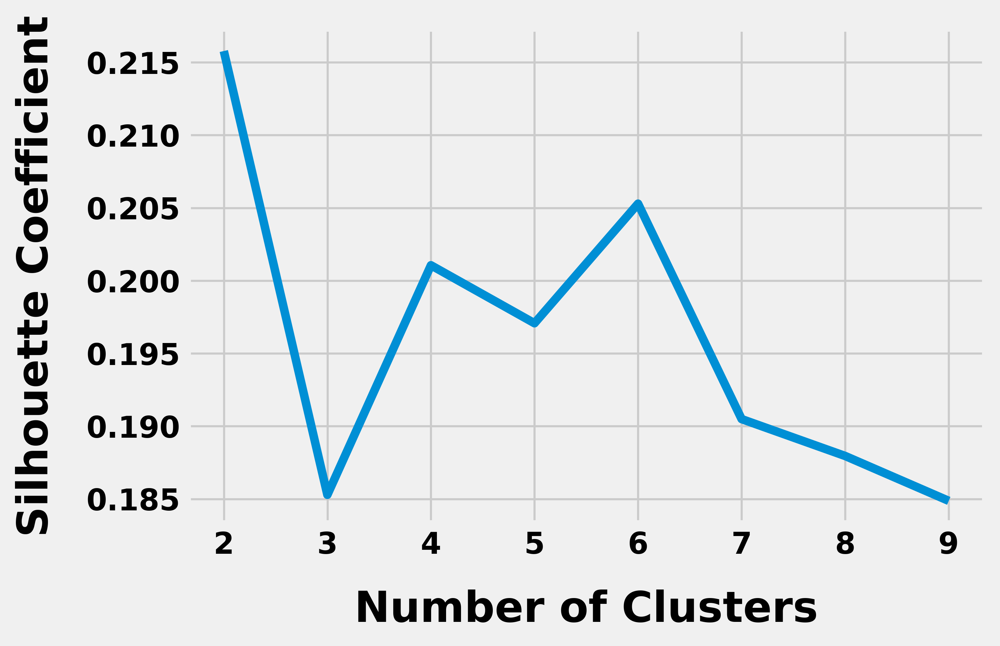

In [79]:
plt.style.use("fivethirtyeight")
plt.plot(range(2, 10), silhouette_coefficients)
plt.xticks(range(2, 10))
plt.xlabel("Number of Clusters", fontsize = 20.0)
plt.ylabel("Silhouette Coefficient", fontsize = 20.0)
plt.savefig("GAG-SilhoutteCoeff.pdf", transparent=True)
plt.show()

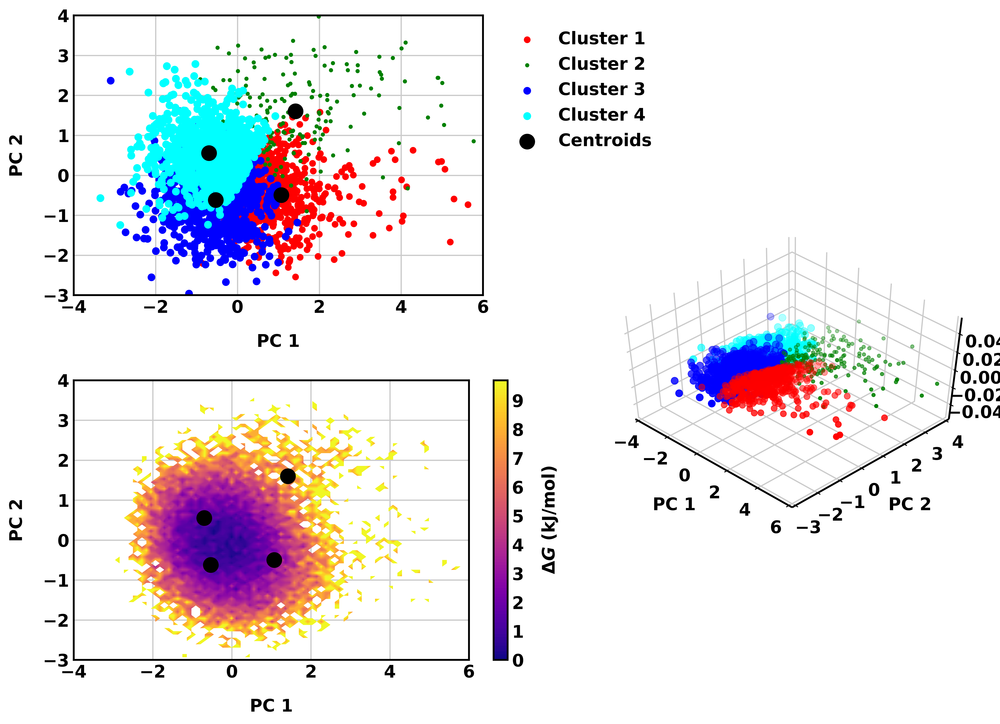

In [36]:
import matplotlib.cm as cmx
from mpl_toolkits.mplot3d import Axes3D
from collections import Counter
plt.rcParams["font.weight"] = "bold"
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams["axes.linewidth"] = 1.5
plt.rcParams["axes.edgecolor"] = "black"
plt.rcParams['font.size'] = 14
plt.rcParams["axes.labelpad"] = 14
plt.rcParams["axes.labelsize"] = "medium"
plt.rcParams["font.serif"] = "Times New Roman"
plt.rcParams["figure.dpi"] = 500
plt.rcParams['axes.facecolor'] = 'white'
plt.rcParams['figure.facecolor'] = 'white'

fig = plt.figure(figsize=(13, 10))
fig.set_facecolor('white')
gs = fig.add_gridspec(10, 12)

#fig = plt.figure(figsize=(10, 8))
#ax2d=fig.add_subplot(111)
ax1d=fig.add_subplot(gs[1:5, 0:5])
ax1d.set_facecolor('white')
ax1d.scatter(x_pca[0:25001:10,][y_kmeans==0, 0], x_pca[0:25001:10,][y_kmeans==0, 1], s=len(df3[model.labels_ == 0])*0.04, c='red', label ='Cluster 1')
ax1d.scatter(x_pca[0:25001:10,][y_kmeans==1, 0], x_pca[0:25001:10,][y_kmeans==1, 1], s=len(df3[model.labels_ == 1])*0.04, c='green', label ='Cluster 2')
ax1d.scatter(x_pca[0:25001:10,][y_kmeans==2, 0], x_pca[0:25001:10,][y_kmeans==2, 1], s=len(df3[model.labels_ == 2])*0.04, c='blue', label ='Cluster 3')
ax1d.scatter(x_pca[0:25001:10,][y_kmeans==3, 0], x_pca[0:25001:10,][y_kmeans==3, 1], s=len(df3[model.labels_ == 3])*0.04, c='cyan', label ='Cluster 4')
#plt.scatter(x_pca[0:25001:50,][y_kmeans==4, 0], x_pca[0:25001:50,][y_kmeans==4, 1], s=50, c='magenta', label ='Cluster 5')
#plt.scatter(x_pca[:,][y_kmeans==5, 0], x_pca[:,][y_kmeans==5, 1], s=50, c='yellow', label ='Cluster 6')
ax1d.set(xlim=(-4, 6),ylim=(-3,4))
ax1d.set_xticks([-4,-2,0,2,4,6])
ax1d.set_yticks([-3,-2,-1,0,1,2,3,4])
plt.scatter(model.cluster_centers_[:, 0], model.cluster_centers_[:, 1], s=150, c='black', label = 'Centroids')
#plt.title('Cluster Density')
plt.xlabel('PC 1')
plt.ylabel('PC 2')
plt.legend(bbox_to_anchor=(1.45, 1.0), loc='upper right',frameon=False)
#plt.legend(bbox_to_anchor=(0.5, 0.1), framealpha=0.5, loc='upper right', ncol =1)


#ax2d = fig.add_subplot(111, projection='3d')
ax2d = fig.add_subplot(gs[4:8, 6:11], projection='3d')
ax2d.view_init(50, -45)
ax2d.w_xaxis.set_pane_color((1,1,1,0))
ax2d.w_yaxis.set_pane_color((1,1,1,0))
ax2d.w_zaxis.set_pane_color((1,1,1,1))
ax2d.set_facecolor('white')
ax2d.scatter(x_pca[0:25001:10,][y_kmeans==0, 0], x_pca[0:25001:10,][y_kmeans==0, 1],\
             s=len(df3[model.labels_ == 0])*0.04, c='red', label ='Cluster 1')
ax2d.scatter(x_pca[0:25001:10,][y_kmeans==1, 0], x_pca[0:25001:10,][y_kmeans==1, 1], \
             s=len(df3[model.labels_ == 1])*0.04, c='green', label ='Cluster 2')
ax2d.scatter(x_pca[0:25001:10,][y_kmeans==2, 0], x_pca[0:25001:10,][y_kmeans==2, 1], \
             s=len(df3[model.labels_ == 2])*0.04, c='blue', label ='Cluster 3')
ax2d.scatter(x_pca[0:25001:10,][y_kmeans==3, 0], x_pca[0:25001:10,][y_kmeans==3, 1], \
             s=len(df3[model.labels_ == 3])*0.04, c='cyan', label ='Cluster 4')

ax2d.set(xlim=(-4, 6),ylim=(-3,4))
ax2d.set_xticks([-4,-2,0,2,4,6])
ax2d.set_yticks([-3,-2,-1,0,1,2,3,4])
#plt.scatter(x_pca[0:25001:50,][y_kmeans==4, 0], x_pca[0:25001:50,][y_kmeans==4, 1], s=50, c='magenta', label ='Cluster 5')
#plt.scatter(x_pca[:,][y_kmeans==5, 0], x_pca[:,][y_kmeans==5, 1], s=50, c='yellow', label ='Cluster 6')
plt.xlabel('PC 1')
plt.ylabel('PC 2')

# from scipy.spatial import ConvexHull

# def encircle(x,y, ax=None, **kw):
#     if not ax: ax=plt.gca()
#     p = np.c_[x,y]
#     hull = ConvexHull(p)
#     poly = plt.Polygon(p[hull.vertices,:], **kw)
#     ax.add_patch(poly)
    
# def encircle2(x,y, ax=None, **kw):
#     if not ax: ax=plt.gca()
#     p = np.c_[x,y]
#     mean = np.mean(p, axis=0)
#     d = p-mean
#     r = np.max(np.sqrt(d[:,0]**2+d[:,1]**2 ))
#     circ = plt.Circle(mean, radius=1.05*r,**kw)
#     ax.add_patch(circ)

ax3d = fig.add_subplot(gs[6:10, 0:6])
ax3d.set_facecolor('white')
# pyemma.plots.plot_free_energy(x_pca[0:25001:10,0], x_pca[0:25001:10,1], ax=ax3d, kT=2.479,cmap='summer',\
#                               cbar_label=r'$\Delta G$' + ' (kJ/mol)')
pyemma.plots.plot_free_energy(x_pca[0:25001,0], x_pca[0:25001,1], ax=ax3d, kT=2.479,cmap='plasma',\
                              cbar_label=r'$\Delta G$' + ' (kJ/mol)')

# encircle2(x_pca[0:25001:10,][y_kmeans==0, 0], x_pca[0:25001:10,][y_kmeans==0, 1],ec='red',fc="none",alpha=2)
# encircle2(x_pca[0:25001:10,][y_kmeans==1, 0], x_pca[0:25001:10,][y_kmeans==1, 1],ec='green',fc="none",alpha=2)
# encircle2(x_pca[0:25001:10,][y_kmeans==2, 0], x_pca[0:25001:10,][y_kmeans==2, 1],ec='blue', fc="none",alpha=2)
# encircle2(x_pca[0:25001:10,][y_kmeans==3, 0], x_pca[0:25001:10,][y_kmeans==3, 1],ec='cyan', fc="none",alpha=2)

ax3d.set(xlim=(-4, 6),ylim=(-3,4))
ax3d.set_xticks([-4,-2,0,2,4,6])
ax3d.set_yticks([-3,-2,-1,0,1,2,3,4])

ax3d.scatter(model.cluster_centers_[:, 0], model.cluster_centers_[:, 1], s=150, c='black', label = 'Centroids')
#plt.title('Free Energy')
plt.xlabel('PC 1')
plt.ylabel('PC 2')
#ax3d.set(zlim=(-1.0, 0.0))
#ax3d.set_zticks(np.arange(0, 4, 2))
#ax3d.set_zlabel(r'$\Delta G$'+' [kcal/mol]')
#plt.legend(loc='best')
#plt.legend(bbox_to_anchor=(-0.3, 1.03),framealpha=0.5, loc='upper left')
plt.savefig("GAGs-kMeans_FES_2d->3d.pdf", transparent=True)
plt.show()

In [80]:
len(df3[model.labels_ == 0]), len(df3[model.labels_ == 1]), len(df3[model.labels_ == 2]), \
len(df3[model.labels_ == 3])

(867, 869, 625, 140)

In [83]:
df3[model.labels_ == 0], df3[model.labels_ == 1], df3[model.labels_ == 2], df3[model.labels_ == 3]

(array([4.000e+02, 2.000e+03, 2.400e+03, 2.800e+03, 3.200e+03, 5.600e+03,
        6.800e+03, 7.600e+03, 1.000e+04, 1.200e+04, 1.240e+04, 1.320e+04,
        1.360e+04, 1.400e+04, 1.440e+04, 1.920e+04, 2.120e+04, 2.160e+04,
        2.200e+04, 2.800e+04, 2.840e+04, 2.880e+04, 2.920e+04, 2.960e+04,
        3.000e+04, 3.120e+04, 3.280e+04, 3.440e+04, 3.600e+04, 3.800e+04,
        3.880e+04, 3.920e+04, 3.960e+04, 4.160e+04, 4.280e+04, 5.720e+04,
        5.760e+04, 6.000e+04, 6.120e+04, 6.160e+04, 6.280e+04, 6.320e+04,
        6.440e+04, 6.600e+04, 6.760e+04, 6.800e+04, 6.840e+04, 6.920e+04,
        6.960e+04, 7.200e+04, 7.320e+04, 7.400e+04, 7.480e+04, 7.640e+04,
        7.720e+04, 7.760e+04, 7.840e+04, 7.920e+04, 7.960e+04, 8.040e+04,
        8.120e+04, 8.320e+04, 8.360e+04, 8.400e+04, 8.440e+04, 8.520e+04,
        8.880e+04, 9.040e+04, 9.240e+04, 9.280e+04, 9.360e+04, 9.400e+04,
        9.520e+04, 9.680e+04, 9.720e+04, 9.760e+04, 1.004e+05, 1.012e+05,
        1.024e+05, 1.032e+05, 1.048e+0

In [84]:
np.savetxt('GAG-cluster0.txt', df3[model.labels_ == 0], fmt='%d', delimiter="\t", header="frame")
np.savetxt('GAG-cluster1.txt', df3[model.labels_ == 1], fmt='%d', delimiter="\t", header="frame")
np.savetxt('GAG-cluster2.txt', df3[model.labels_ == 2], fmt='%d', delimiter="\t", header="frame")
np.savetxt('GAG-cluster3.txt', df3[model.labels_ == 3], fmt='%d', delimiter="\t", header="frame")

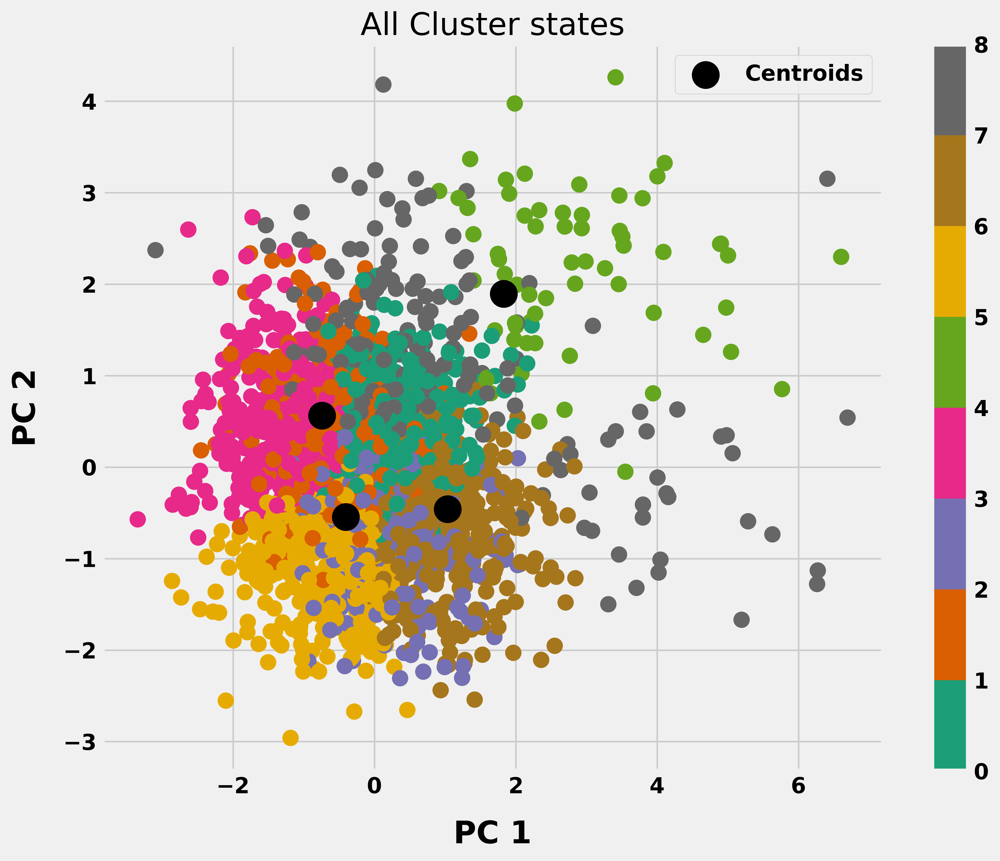

In [85]:
fig = plt.figure(figsize=(10, 8))
m=plt.scatter(x_pca[0:25001:10,0], x_pca[0:25001:10,1], s=100, c=ks.labels_, cmap='Dark2')
#plt.scatter(x_pca[:,][y_kmeans==4, 0], x_pca[:,][y_kmeans==4, 1], s=50, c='magenta'
#plt.scatter(x_pca[:,][y_kmeans==4, 0], x_pca[:,][y_kmeans==4, 1], s=50, c='magenta', label ='Cluster 5')
#plt.scatter(x_pca[:,][y_kmeans==5, 0], x_pca[:,][y_kmeans==5, 1], s=50, c='yellow', label ='Cluster 6')
plt.colorbar(m)
plt.scatter(model.cluster_centers_[:, 0], model.cluster_centers_[:, 1], s=300, c='black', label = 'Centroids')
plt.title('All Cluster states', fontsize = 20.0)
plt.xlabel('PC 1', fontsize = 20.0)
plt.ylabel('PC 2', fontsize = 20.0)
plt.legend()
plt.show()

In [86]:
model.cluster_centers_

array([[-0.74079649,  0.56206809, -0.55185243,  0.04429269],
       [-0.4054295 , -0.54505148,  0.69949675,  0.07539117],
       [ 1.0345543 , -0.45970462, -0.57067144, -0.07911392],
       [ 1.82920961,  1.89490719,  1.31128292, -0.89700918]])

# DBSCAN

In [87]:
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(x_pca)
distances, indices = nbrs.kneighbors(x_pca)

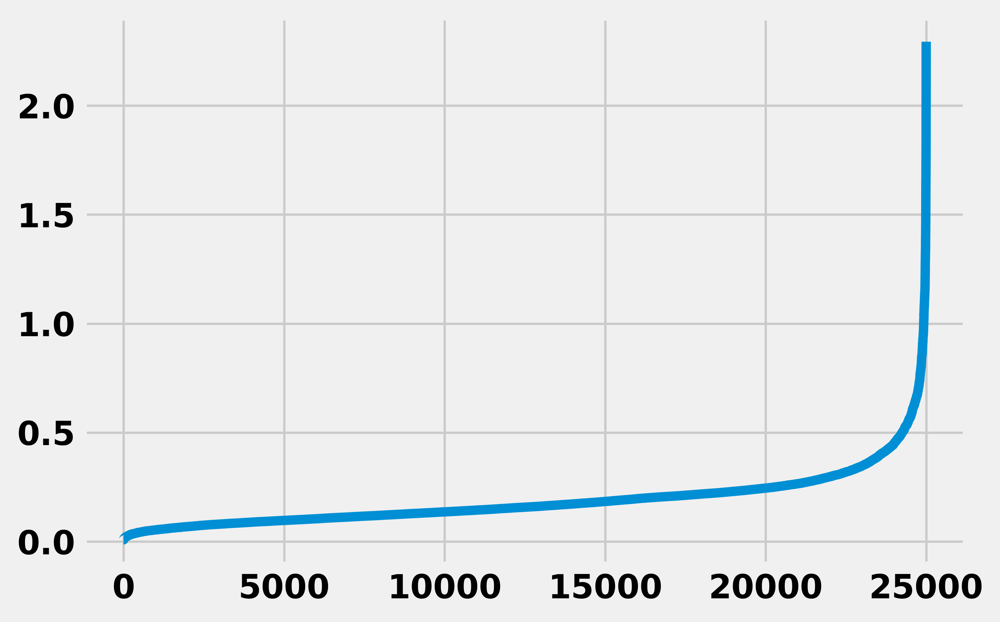

In [88]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [89]:
m = DBSCAN(eps=0.5, min_samples=100)
m.fit(x_pca)

DBSCAN(min_samples=100)

In [90]:
clusters = m.labels_

In [91]:
colors = ['royalblue', 'cyan', 'forestgreen', 'mediumorchid', 'tan', 'deeppink', 'olive', 'goldenrod', 'lightcyan', 'red']
vectorizer = np.vectorize(lambda x: colors[x % len(colors)])

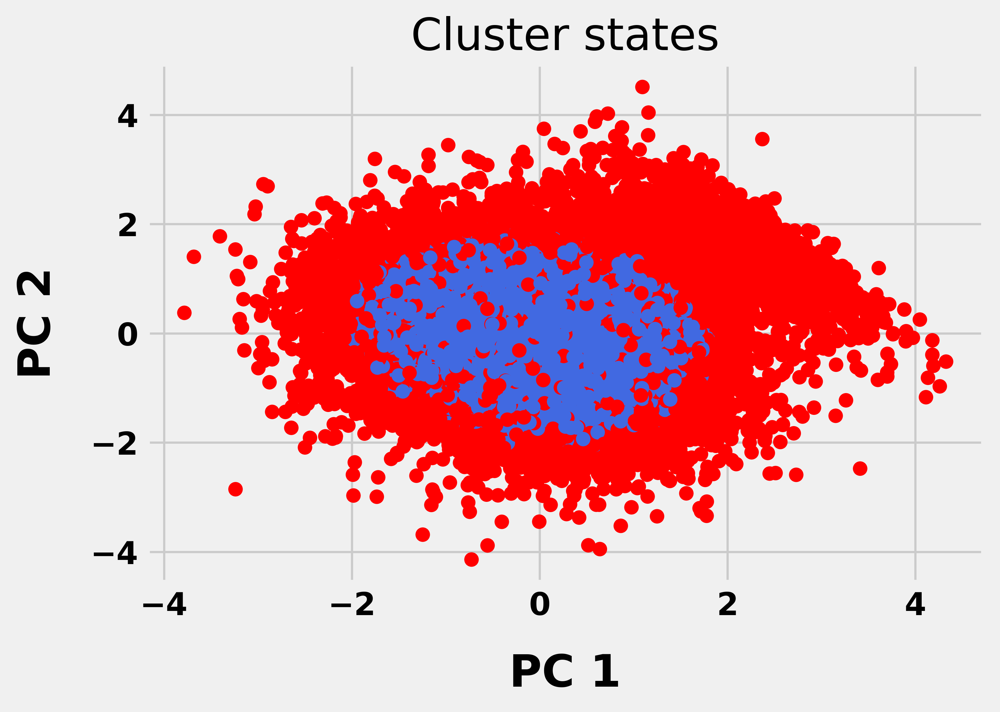

In [92]:
plt.scatter(x_pca[:,1], x_pca[:,2], c=vectorizer(clusters))
plt.title('Cluster states', fontsize = 20.0)
plt.xlabel('PC 1', fontsize = 20.0)
plt.ylabel('PC 2', fontsize = 20.0)
plt.show()

# Compare clustering between K-Means and DBSCAN

In [93]:
# Instantiate k-means and dbscan algorithms
kmeans = KMeans(n_clusters=4)
dbscan = DBSCAN(eps=0.5, min_samples=100)

# Fit the algorithms to the features
kmeans.fit(x_pca[:,])
dbscan.fit(x_pca[:,])

# Compute the silhouette scores for each algorithm
kmeans_silhouette = silhouette_score(x_pca[:,], kmeans.labels_).round(2)
dbscan_silhouette = silhouette_score(x_pca[:,], dbscan.labels_).round(2)

In [94]:
kmeans_silhouette

0.2

In [95]:
dbscan_silhouette

0.19

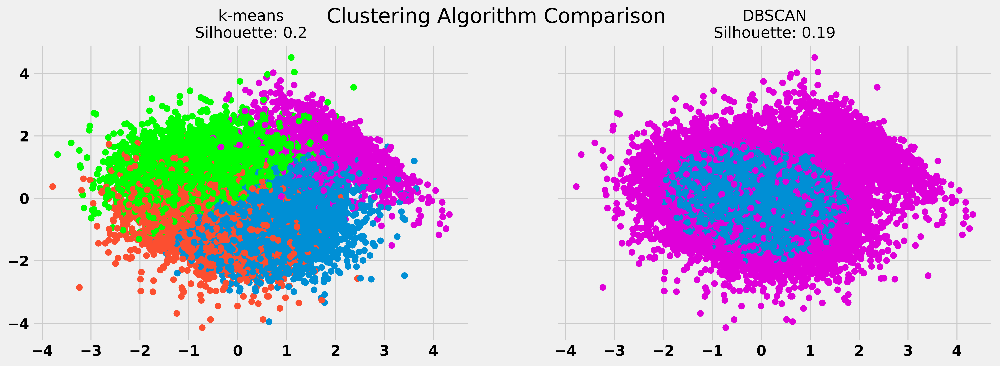

In [96]:
 # Plot the data and cluster silhouette comparison
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5), sharex=True, sharey=True)
fig.suptitle(f"Clustering Algorithm Comparison", fontsize=20)
fte_colors = {0: "#008fd5",1: "#fc4f30",2:"#00ff00",3:"#df00d9"}
fte_colors1 = {0: "#008fd5",1: "#fc4f30",2:"#00ff00",-1:"#df00d9"}
# The k-means plot
km_colors = [fte_colors[label] for label in kmeans.labels_]
ax1.scatter(x_pca[:, 1], x_pca[:, 2], c=km_colors)
ax1.set_title(f"k-means\nSilhouette: {kmeans_silhouette}", fontdict={"fontsize": 15})

# The dbscan plot
db_colors = [fte_colors1[label] for label in dbscan.labels_]
ax2.scatter(x_pca[:, 1], x_pca[:, 2], c=db_colors)
ax2.set_title(f"DBSCAN\nSilhouette: {dbscan_silhouette}", fontdict={"fontsize": 15})
plt.show()

# TICA

In [97]:
tica_obj_gag_2D = pyemma.coordinates.tica(scaled_data, lag=1, dim=3)

In [98]:
print('dimension for gags on first two tica spaces:',tica_obj_gag_2D.dimension())

dimension for gags on first two tica spaces: 3


In [99]:
tics_gag_2D = tica_obj_gag_2D.get_output()
tics_gag_2D_conc=np.concatenate(tics_gag_2D)

Text(0, 0.5, 'TICA 2')

<Figure size 3000x2000 with 0 Axes>

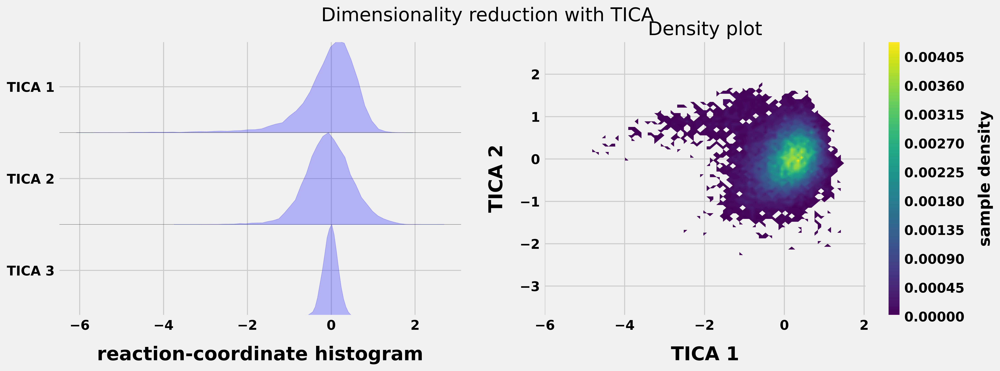

In [100]:
plt.suptitle('Dimensionality reduction with TICA')
fig, axes = plt.subplots(1, 2, figsize=(15, 5))
fig.suptitle('Dimensionality reduction with TICA', fontsize = 20.0)
pyemma.plots.plot_feature_histograms(tics_gag_2D_conc, feature_labels=['TICA 1', 'TICA 2', 'TICA 3'], ax=axes[0])
axes[0].set_xlabel('reaction-coordinate histogram', fontsize = 20.0)
#pyemma.plots.plot_density(*tics_gag_2D_conc.T, ax=axes[1])
pyemma.plots.plot_density(tics_gag_2D_conc[:,0],tics_gag_2D_conc[:,1], ax=axes[1])
axes[1].set_title('Density plot', fontsize = 20.0)
axes[1].set_xlabel('TICA 1', fontsize = 20.0)
axes[1].set_ylabel('TICA 2', fontsize = 20.0)

<Figure size 7500x2500 with 0 Axes>

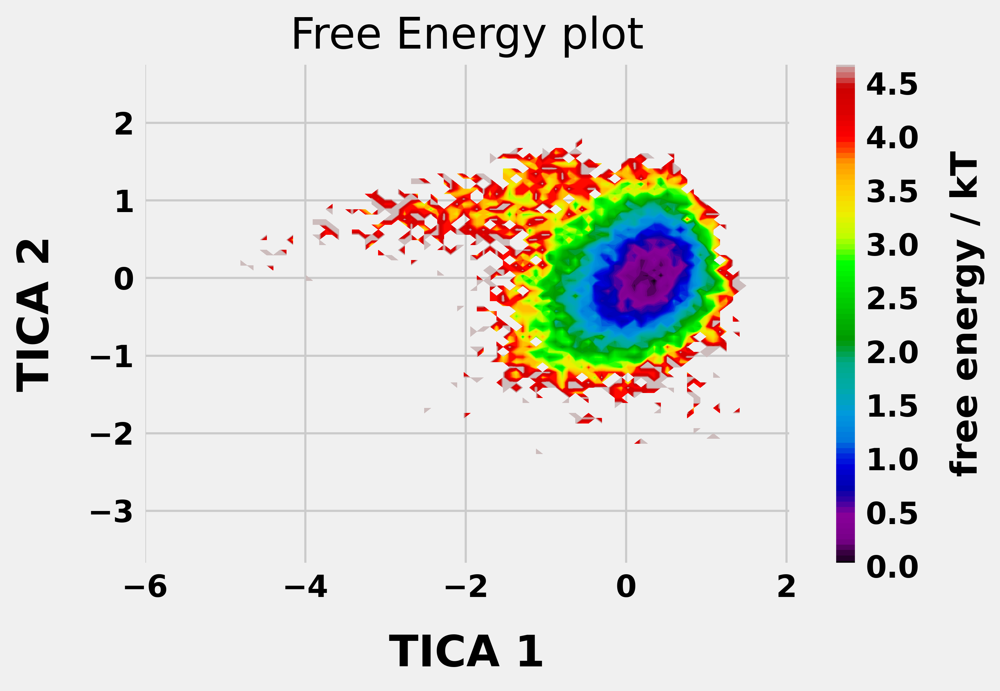

In [101]:
plt.figure(figsize=(15,5))
pyemma.plots.plot_free_energy(np.vstack(tics_gag_2D)[:,0], np.vstack(tics_gag_2D)[:,1])
plt.title('Free Energy plot', fontsize = 20.0)
plt.xlabel('TICA 1', fontsize = 20.0)
plt.ylabel('TICA 2', fontsize = 20.0)
plt.show()

# PCA

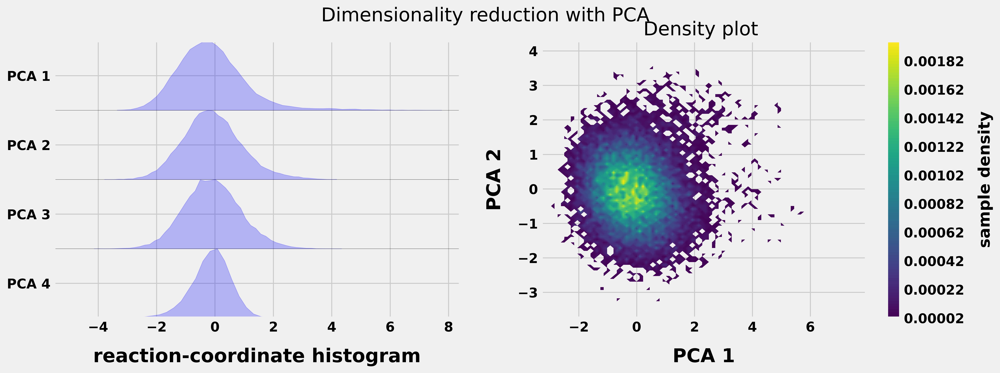

In [111]:
fig, axes = plt.subplots(1, 2, figsize=(15, 5))
pyemma.plots.plot_feature_histograms(x_pca, feature_labels=['PCA 1','PCA 2','PCA 3','PCA 4'], ax=axes[0])
fig.suptitle('Dimensionality reduction with PCA', fontsize = 20.0)
axes[0].set_xlabel('reaction-coordinate histogram', fontsize = 20.0)
#pyemma.plots.plot_density(*x_pca.T, ax=axes[1])
pyemma.plots.plot_density(x_pca[:,0],x_pca[:,1], ax=axes[1])
axes[1].set_title('Density plot ', fontsize = 20.0)
axes[1].set_xlabel('PCA 1', fontsize = 20.0)
axes[1].set_ylabel('PCA 2', fontsize = 20.0)
plt.savefig("GAG-DBSCAN-sample_density.pdf", transparent=True)

In [106]:
plt.figure(figsize=(40,105))
plt.subplot2grid((10,1),(0,0))
plt.plot(x_pca[:,0])
plt.xticks(np.arange(0, 25001, 5000), fontsize = 20.0)
plt.yticks( fontsize = 20.0)
plt.ylabel('PCA 1', fontsize = 20.0)
plt.subplot2grid((10,1),(1,0))
plt.plot(x_pca[:,1])
plt.ylabel('PCA 2', fontsize = 20.0)
plt.xticks(np.arange(0, 25001, 5000), fontsize = 20.0)
plt.yticks( fontsize = 20.0)
plt.subplot2grid((10,1),(2,0))
plt.plot(x_pca[:,2])
plt.ylabel('PCA 3', fontsize = 20.0)
plt.xticks(np.arange(0, 25001, 5000), fontsize = 20.0)
plt.yticks( fontsize = 20.0)
plt.subplot2grid((10,1),(3,0))
plt.plot(x_pca[:,2])
plt.ylabel('PCA 4', fontsize = 20.0)
plt.xticks(np.arange(0, 25001, 5000), fontsize = 20.0)
plt.yticks( fontsize = 20.0)
plt.xlabel('Number of frames', fontsize = 20.0)

Text(0.5, 0, 'Number of frames')

<Figure size 5000x4000 with 0 Axes>

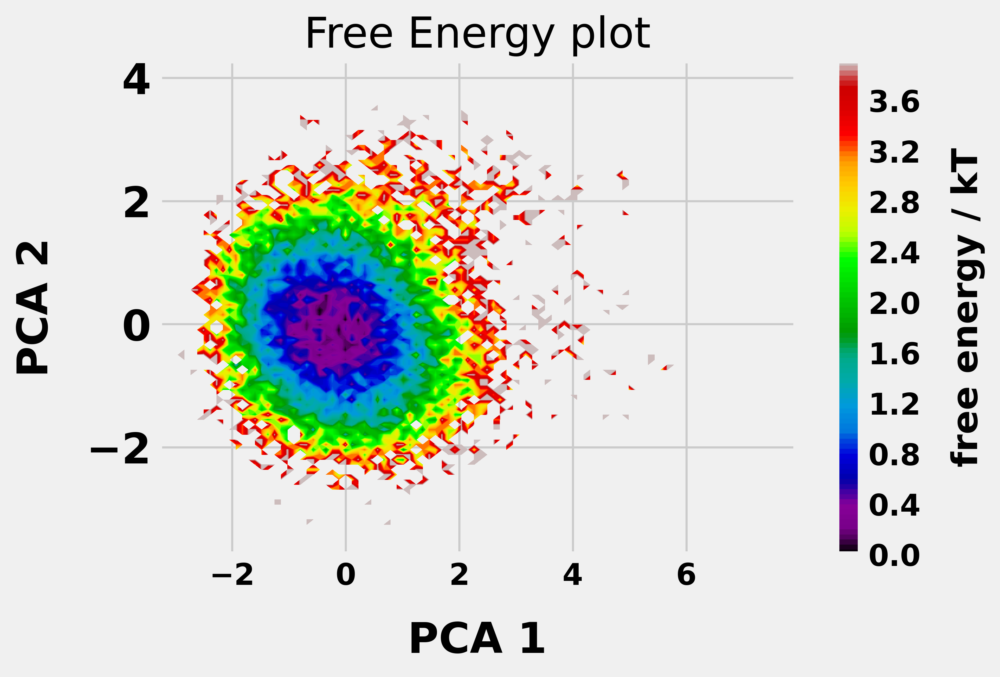

In [110]:
plt.figure(figsize=(10,8))
pyemma.plots.plot_free_energy(np.vstack(x_pca)[:,0], np.vstack(x_pca)[:,1])
plt.title('Free Energy plot', fontsize = 20.0)
plt.xlabel('PCA 1', fontsize = 20.0)
plt.ylabel('PCA 2', fontsize = 20.0)
plt.yticks( fontsize = 20.0)
plt.savefig("GAG-DBSCAN-FEL_PC.pdf", transparent=True)
plt.show()

In [109]:
#z1=np.linspace(min(chain(x_pca[:,0], x_pca[:,1])),max(chain(x_pca[:,0], x_pca[:,1])), 2001)
#z1

# Transition in Trajectory 

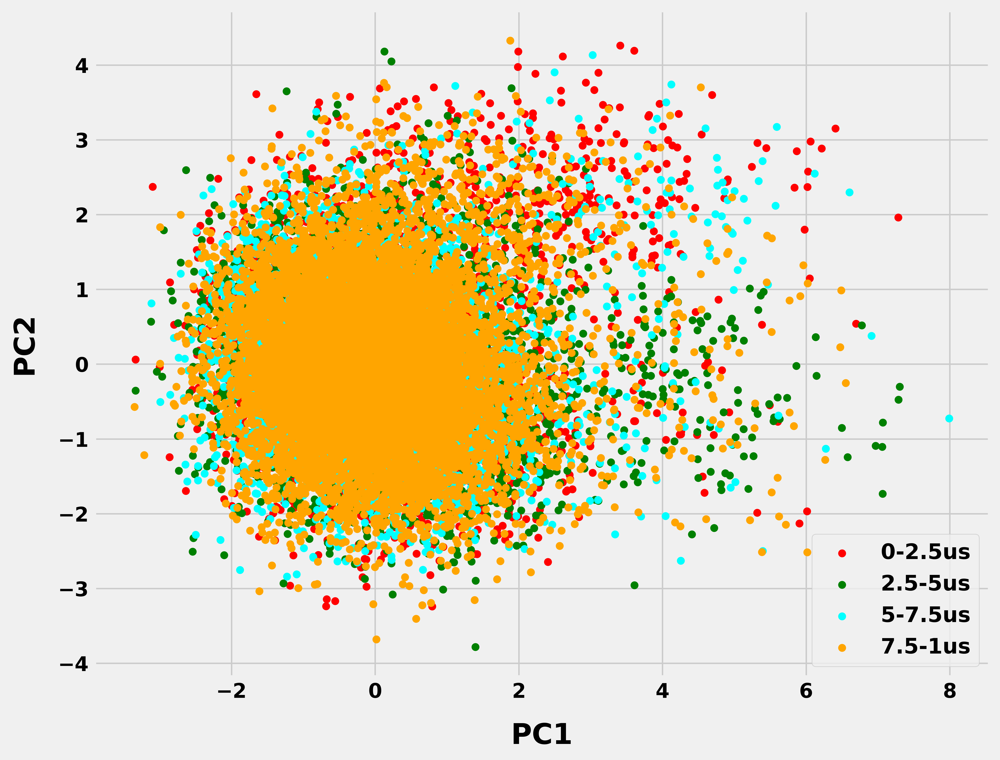

In [112]:
fig = plt.figure(figsize=(10,8))
plt.scatter(x_pca[0:5000,0],x_pca[0:5000,1],s=100, c='r',label='0-2.5us', marker='.')
plt.scatter(x_pca[5001:10000,0],x_pca[5001:10000,1],s=100, c='g',label='2.5-5us', marker='.')
plt.scatter(x_pca[10001:15000,0],x_pca[10001:15000,1],s=100, c='cyan',label='5-7.5us', marker='.')
plt.scatter(x_pca[15001:25000,0],x_pca[15001:25000,1],s=100, c='orange',label='7.5-1us', marker='.')
plt.xlabel('PC1', fontsize = 20.0)
plt.ylabel('PC2', fontsize = 20.0)
plt.legend(fontsize = 15.0)

# HDBSCAN

In [113]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=50, min_samples=10).fit(x_pca)

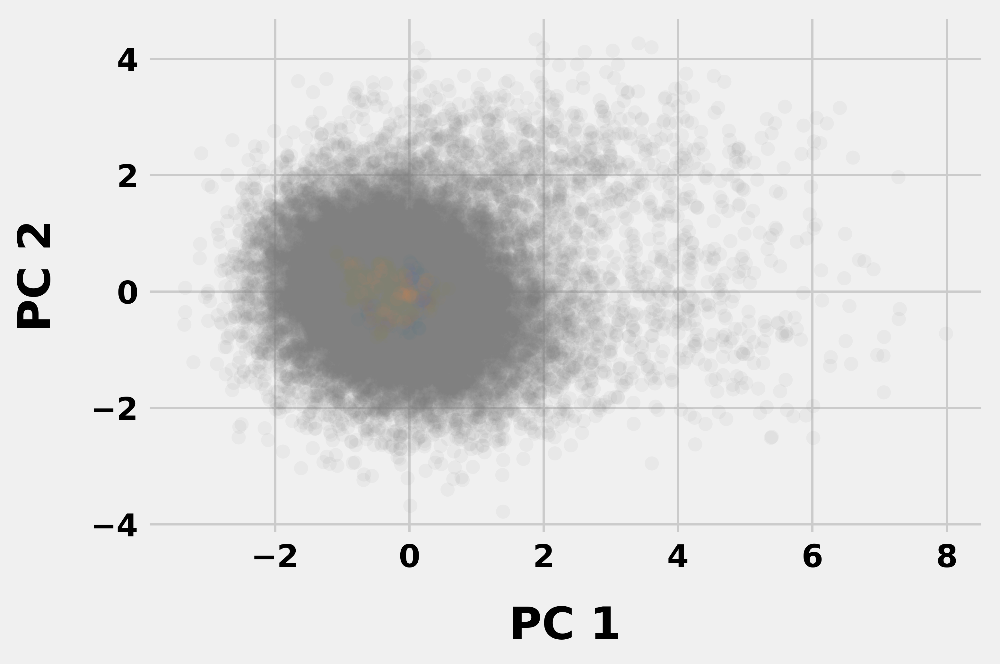

In [114]:
color_palette = sns.color_palette('muted', 4)
cluster_colors = [color_palette[x] if x >= 0
                  else (0.5, 0.5, 0.5)
                  for x in clusterer.labels_]
cluster_member_colors = [sns.desaturate(x, p) for x, p in
                         zip(cluster_colors, clusterer.probabilities_)]
#fig, ax = plt.subplots()
#plt.scatter(*x_pca.T, s=40, linewidth=0, c=cluster_member_colors, alpha=0.07)
plt.scatter(x_pca[:,0], x_pca[:,1], s=40, linewidth=0, c=cluster_member_colors, alpha=0.07)
plt.xlabel('PC 1', fontsize = 20.0)
plt.ylabel('PC 2', fontsize = 20.0);

# Outlier Detection

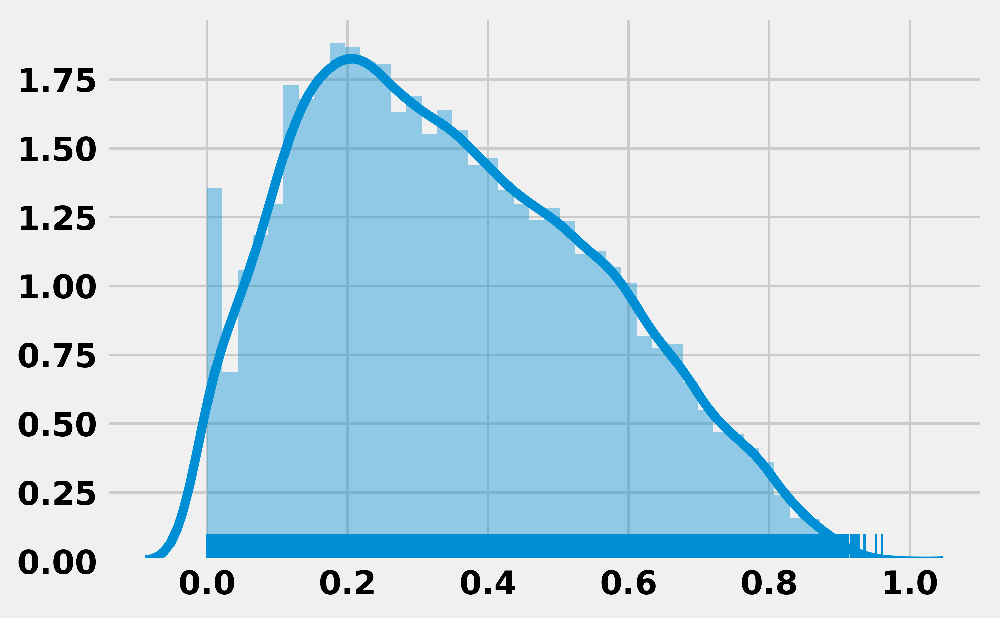

In [115]:
sns.distplot(clusterer.outlier_scores_[np.isfinite(clusterer.outlier_scores_)], rug=True)